---
title: DiffEdit Paper Implementation
toc: true
date: "2024-05-04"
author: Suchit G
description: This was more mind-bending than I expected 😅. Watch me as I make it seem so simple in this blog 😎
image: "./thumbnail.png"
categories:
    - Stable Diffusion
    - Paper Implementation
---

This blog _delves_ into the implementation of the [DiffEdit paper](https://arxiv.org/abs/2210.11427). For a beginner who had just learned about SD, implementing this was a little difficult with me misunderstanding so many things in the paper. I will point them out and provide a clear explanation of my implementation in this post. I did have a few (or more than a few 🙂) peeks at other implementations, primarily [this](https://www.kaggle.com/code/jonnyspruce/diffedit) and [this](https://towardsdatascience.com/stable-diffusion-using-hugging-face-diffedit-paper-implementation-e4c99e3e320c). They were helpful in correcting some of my misconceptions.

# 1. Background on Stable Diffusion

The diffusion approach is used in modelling complex datasets. The training process involves destroying structure in a data distribution through a forward diffusion process (comparable to adding noise in SD). The model learns to reverse this diffusion process to restore structure in the data. This process, according to my knowledge, was first introduced in [Deep Unsupervised Learning using Nonequilibrium Thermodynamics by Sohl-Dickstein et al.](https://arxiv.org/abs/1503.03585). The training objective was to learn the transition parameters (mean and covariance?) to go from $x_t \rightarrow x_{t-1}$.

How might we, then, apply this to generating images?

The [Denoising Diffusion Probabilistic Models](https://arxiv.org/abs/2006.11239) paper improved the denoising process by introducing a different training objective. The training objective here directly predicted the noise to go from $x_t \rightarrow x_0$. However, $x_0$ is not used directly as the samples produced will be relatively poor and blurry. Instead, at each update step the input is denoised in a controlled fashion with controlled noise being added (the paper has a lot of math and I couldn't understand the core part of the update process).

Then came [Stable Diffusion](https://arxiv.org/abs/2112.10752) which *I think* introduced text conditioned image generation using diffusion models. The main contributions were making the diffusion and denoising process more efficient by applying them in the latent space of pretrained autoencoders (VAEs), and using CLIP for text conditioned generation.

So, in simple words, during inference, a SD model takes in pure Gaussian noise, iteratively removes noise from the input based on the conditioning text.

Implementation of common SD pipelines can be found in [this notebook](https://github.com/fastai/diffusion-nbs/blob/master/Stable%20Diffusion%20Deep%20Dive.ipynb) with a walkthrough in [this video](https://www.youtube.com/watch?v=0_BBRNYInx8), both authored by [Jonathan Whitaker](https://johnowhitaker.dev).

# 2. Introduction

DiffEdit was an early attempt at editing images using Stable Diffusion models. Here's an outline of its workings:

- The image to be edited, "query prompt" and a "reference prompt" are given as inputs.
- Based on the reference prompt, a mask is generated over what the prompt describes.
- The rest of the process is very similar to the img2img pipeline. Variable strength noise is added to the input image and the query prompt is given as the conditional prompt. After denoising at each timestep, the area not covered by the mask is replaced with the latent values of the original image and the resultant latent is used as the latent input for the next timestep.

# 3. Implementing DiffEdit

## 3.1. Imports

Please excuse the weird cell metadata showing up here. I tried my best to remove them, but couldn't.

In [1]:
!pip install -q --upgrade transformers==4.25.1 diffusers ftfy accelerate

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
kaggle-environments 1.14.3 requires transformers>=4.33.1, but you have transformers 4.25.1 which is incompatible.


In [2]:
from tqdm.auto import tqdm
from diffusers import AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler
from transformers import CLIPTextModel, CLIPTokenizer
from PIL import Image
import torchvision.transforms as tfms
import torch
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

2024-05-04 04:35:21.379115: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-04 04:35:21.379220: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-04 04:35:21.520888: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


Moving 0 files to the new cache system


0it [00:00, ?it/s]

## 3.2. Models and Helper Functions

In [3]:
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to('cuda')
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet").to('cuda')
scheduler = LMSDiscreteScheduler(beta_schedule="scaled_linear")

tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14").to('cuda')

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/961k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.52k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

Some weights of the model checkpoint at openai/clip-vit-large-patch14 were not used when initializing CLIPTextModel: ['vision_model.encoder.layers.7.mlp.fc2.weight', 'vision_model.encoder.layers.9.layer_norm2.bias', 'vision_model.encoder.layers.9.layer_norm1.weight', 'vision_model.encoder.layers.17.mlp.fc1.weight', 'vision_model.encoder.layers.18.self_attn.v_proj.weight', 'vision_model.encoder.layers.1.layer_norm1.bias', 'vision_model.encoder.layers.4.layer_norm2.weight', 'vision_model.encoder.layers.5.self_attn.q_proj.weight', 'vision_model.encoder.layers.14.layer_norm1.weight', 'vision_model.encoder.layers.22.mlp.fc1.bias', 'vision_model.encoder.layers.14.mlp.fc2.bias', 'vision_model.encoder.layers.6.mlp.fc2.bias', 'vision_model.encoder.layers.23.self_attn.k_proj.bias', 'vision_model.encoder.layers.13.self_attn.v_proj.bias', 'vision_model.encoder.layers.13.self_attn.q_proj.weight', 'vision_model.encoder.layers.2.mlp.fc1.bias', 'vision_model.encoder.layers.13.self_attn.q_proj.bias', '

In [4]:
def latents_to_pil(latents):
    latents = latents / 0.18215
    with torch.no_grad():
        images = vae.decode(latents).sample
        
    images = (images / 2 + 0.5).clamp(0,1)
    images = images.detach().cpu().permute(0, 2, 3, 1).numpy()
    images = (images * 255).round().astype('uint8')
    pil_images = [Image.fromarray(image) for image in images]
    return pil_images

def pil_to_latent(input_image):
    with torch.no_grad():
        latent = vae.encode(tfms.ToTensor()(input_image).unsqueeze(0).to('cuda') * 2 - 1)
    return 0.18215*latent.latent_dist.sample()

It is worth spending some time here to understand the functions `latents_to_pil` and `pil_to_latent`.

`latents = latents / 0.18215` - the latents are scaled by `0.18215` before being fed to the diffusion model to have approximately unit variance (I don't know why it should have unit variance). So, we divide it by that much to get back the original representation of the latent to then convert it into an image. Check out this [GitHub issue](https://github.com/huggingface/diffusers/issues/437) where one of the creators of Stable Diffusion has answered the question!

`images = (images / 2 + 0.5).clamp(0,1)` - normalizing the images to be in the range [0, 1]

`images = images.detach().cpu().permute(0, 2, 3, 1).numpy()` - pil expects image dims in different order - H,W,C - whereas the VAE gives - C,H,W

And then we scale the values by 255.

The `pil_to_latent` function is pretty straightforward - the image is passed through the VAE, and then scaled.

We will define some helper functions to visualize the latents we create and the intermediate steps during diffusion. Before that, Let's download an image of a baseball as an example to edit.

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  107k  100  107k    0     0  1017k      0 --:--:-- --:--:-- --:--:-- 1021k


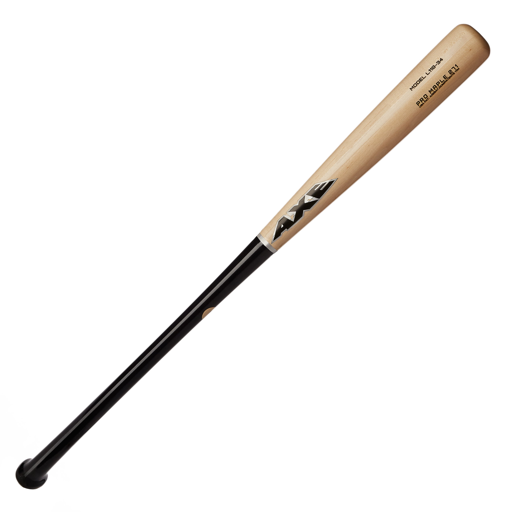

In [5]:
!curl --output baseball_bat.jpg 'https://i5.walmartimages.com/asr/569620aa-0bf3-48a9-9b86-5316127419b2_1.bfbc8c8759fe8f2f2c394f394ee66351.jpeg'
img = Image.open('baseball_bat.jpg').resize((512, 512)); img

In [7]:
def vis_latent(latent, cmap='Greys'):
    fig, axs = plt.subplots(1, 4, figsize=(10, 16))
    for i in range(4):
        axs[i].imshow(latent[0][i].cpu(), cmap=cmap)
        
def accumulate_images(latent, img_list):
    img_list.append(
        latents_to_pil(latent)[0]
    )
    
# Code taken from https://github.com/fastai/diffusion-nbs/blob/master/stable_diffusion.ipynb
def image_grid(imgs):
    w,h = imgs[0].size
    cols = len(imgs) if len(imgs) < 10 else 10
    rows = int(len(imgs) / cols) + 1
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols * w, i//cols * h))
        
    return grid

Let's try out the `vis_latent` function, and the latent and PIL conversion functions.

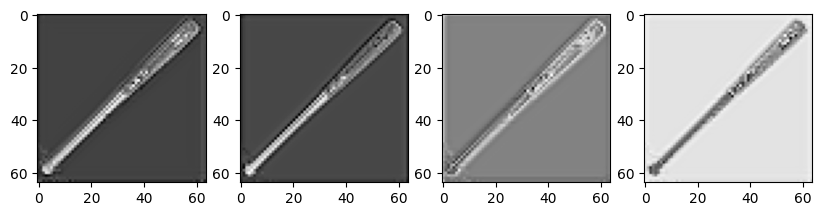

In [8]:
l = pil_to_latent(img); vis_latent(l)

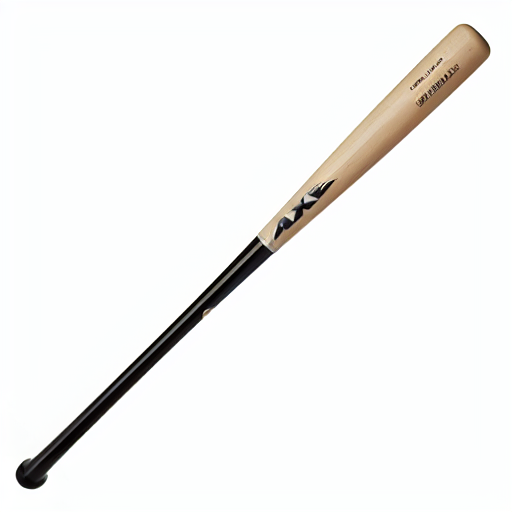

In [9]:
i = latents_to_pil(l); i[0]

`get_emb_from_prompt` takes a prompt, tokenizes it and gives its embeddings.

In [10]:
def get_emb_from_prompt(prompt):
    tokens = tokenizer(prompt, max_length=tokenizer.model_max_length, padding='max_length', truncation=True, return_tensors='pt').to('cuda')
    with torch.no_grad():
        text_emb = text_encoder(tokens.input_ids)[0]
    return text_emb

## 3.3. DiffEdit

We will be closely following what's mentioned in the [DiffEdit paper](https://arxiv.org/pdf/2210.11427) for this implementation, primarily sections 3.1 and 3.2.

Here's a screenshot from section 3.1 that gives an overview of the DiffEdit framework.

<a href='https://postimages.org/' target='_blank'><img src='https://i.postimg.cc/sgJRCnG2/diffedit-steps-paper.png' border='0' alt='A screenshot from the DiffEdit paper that describes the framework pictorially.'/></a>

### 3.3.1. Step 1: Computing Editing Mask

Add noise to the input image and denoise it: once conditioned on the query text, and once conditioned on a reference text (or unconditionally). We derive a mask based on the difference in the denoising results.

The model, when conditioned on the query text, gives a noise output that covers everything that isn't what is described by the query text. So, if we were to set `query_prompt` to "pixelated minecraft stick", the noise output would cover the baseball bat. When it is conditioned on the reference text, that describes the original image, the noise output covers everything except the baseball bat that the reference text describes. When we take the difference of these two noise latents, we get an area that covers only the part which is to be edited.

Let's see this in action.

::: {.callout-note collapse="true"}
A mistake I made here is that I mistook the the phrase "denoise it" to be the entire diffusion denoising process for `inference_steps` number of steps. This cost me a week's time and I gave in to peeking at another implementation only to find out that I was overthinking :')
:::

In [11]:
torch.manual_seed(42)

# denoising conditioned on the query text
query_emb = get_emb_from_prompt("pixelated minecraft stick")
im_latent = pil_to_latent(img)
guidance = 7
inference_steps = 50
# timestep_index is set to 25 because we are adding 50% noise like in the paper
timestep_index = 25

# following is a regular img2img pipeline that denoises for a single step
scheduler.set_timesteps(inference_steps)
noise_timestep = scheduler.timesteps[-timestep_index]
uncond_emb = get_emb_from_prompt("")
text_embeddings = torch.cat([uncond_emb, query_emb])

noise = torch.randn_like(im_latent, device='cuda')
noisy_latent = scheduler.add_noise(im_latent, noise, timesteps=torch.tensor([noise_timestep]))
noisy_latent = noisy_latent * scheduler.sigmas[timestep_index]

latent_model_input = torch.cat([noisy_latent] * 2)
latent_model_input = scheduler.scale_model_input(latent_model_input, noise_timestep)

with torch.no_grad():
    pred_uncond, pred_cond = unet(latent_model_input, noise_timestep, encoder_hidden_states=text_embeddings).sample
    
query_noise_pred = pred_uncond + guidance * (pred_cond - pred_uncond)
query_noise_pred = query_noise_pred[None].detach()

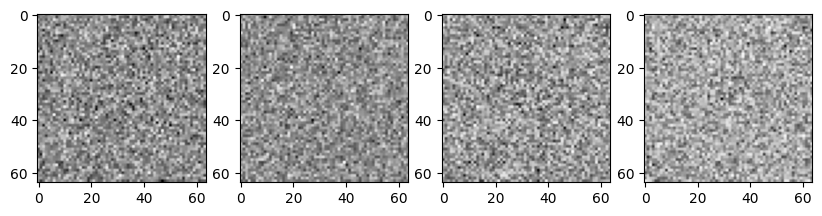

In [12]:
vis_latent(query_noise_pred)

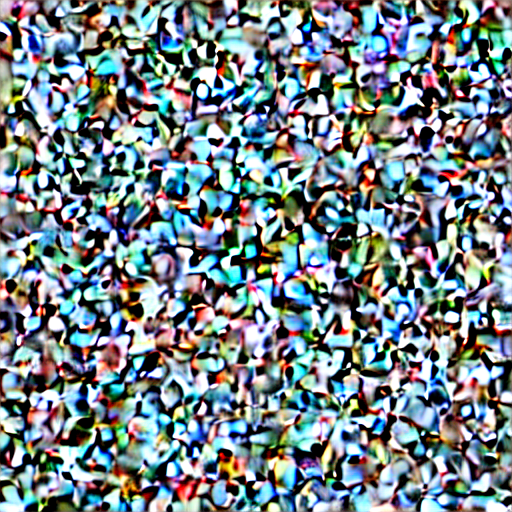

In [13]:
latents_to_pil(query_noise_pred.cuda())[0]

We can put that in a function and compute the difference between the noise conditioned on the query prompt and the noise conditioned on the reference prompt.

In [14]:
def predict_noise(im_latent, prompt_emb, uncond_emb, seed=42, strength=0.5):
    torch.manual_seed(seed)
    guidance = 7
    inference_steps = 50
    timestep_index = int(inference_steps * strength)

    # following is a regular img2img pipeline that denoises for a single step
    scheduler.set_timesteps(inference_steps)
    noise_timestep = scheduler.timesteps[-timestep_index]
    text_embeddings = torch.cat([uncond_emb, prompt_emb])

    noise = torch.randn_like(im_latent, device='cuda')
    noisy_latent = scheduler.add_noise(im_latent, noise, timesteps=torch.tensor([noise_timestep]))
    noisy_latent = noisy_latent * scheduler.sigmas[timestep_index]

    latent_model_input = torch.cat([noisy_latent] * 2)
    latent_model_input = scheduler.scale_model_input(latent_model_input, noise_timestep)

    with torch.no_grad():
        pred_uncond, pred_cond = unet(latent_model_input, noise_timestep, encoder_hidden_states=text_embeddings).sample

    noise_pred = pred_uncond + guidance * (pred_cond - pred_uncond)
    return noise_pred[None]

In [15]:
ref_emb = get_emb_from_prompt("baseball bat")
ref_noise_pred = predict_noise(im_latent, ref_emb, uncond_emb)

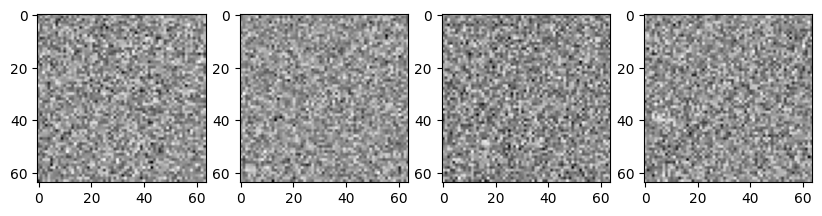

In [16]:
vis_latent(ref_noise_pred)

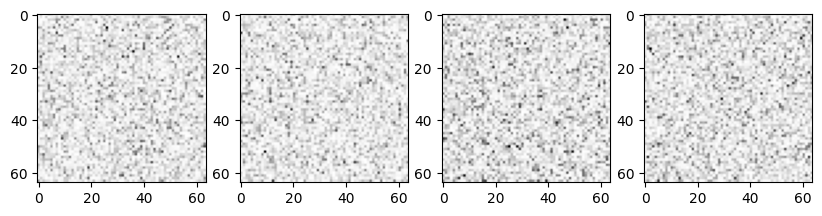

In [17]:
vis_latent((ref_noise_pred - query_noise_pred).abs())

We have to repeat the process for a set of `n` input noises and average the differences to get a more prominent difference.

The paper uses `n=10`, but in my experiments `n=15` gave slightly better noise differences.

::: {.callout-note collapse="true"}
Here, note that we need to use a set of `n` input noises generated from different seeds.
:::

In [18]:
# noise_r, noise_q, diff_noise = [torch.zeros_like(im_latent) for _ in range(3)]
noise_diff = torch.zeros_like(im_latent)

for i in tqdm(range(15)):
    seed = i * 4
    noise_r = predict_noise(im_latent, ref_emb, uncond_emb, seed, 0.6)
    noise_q = predict_noise(im_latent, query_emb, uncond_emb, seed, 0.6)
    noise_diff += (noise_r - noise_q).abs()
    
# averaging
noise_diff /= 15

  0%|          | 0/15 [00:00<?, ?it/s]

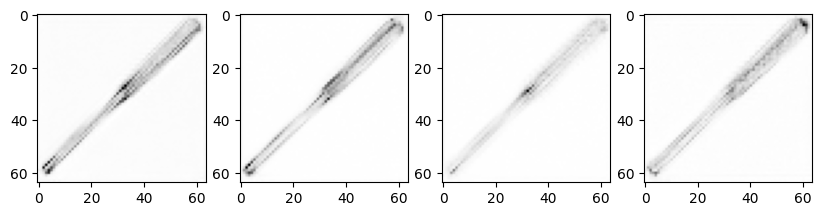

In [19]:
vis_latent(noise_diff)

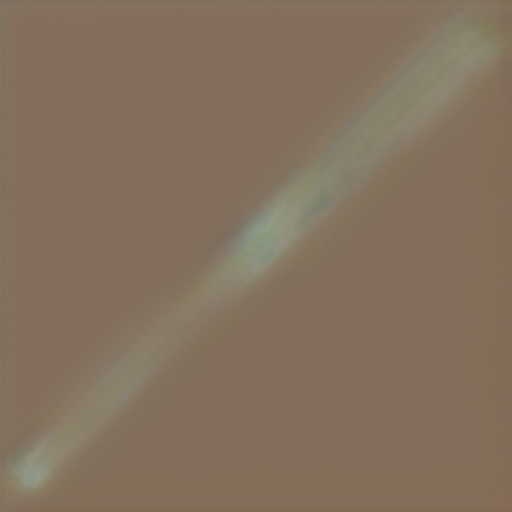

In [20]:
latents_to_pil(noise_diff)[0]

In [21]:
def compute_diff(im_latent, query_emb, ref_emb, uncond_emb, n=15, seed=42):
    noise_diff = torch.zeros(1, unet.config.in_channels, 512//8, 512//8).to('cuda')

    print("Computing average noise estimate difference ...")
    for i in tqdm(range(n)):
        seed *= i # arbitrary operation to get a seed
        noise_r = predict_noise(im_latent, ref_emb, uncond_emb, seed, 0.5)
        noise_q = predict_noise(im_latent, query_emb, uncond_emb, seed, 0.5)
        noise_diff += (noise_r - noise_q).abs()
    
    return noise_diff / n

The noise difference does not look all that interesting until we binarize it with a threshold.

In [22]:
noise_diff.shape

torch.Size([1, 4, 64, 64])

We first take the mean of the 4 channels in the latent and normalize it.

In [23]:
mask = noise_diff
mask = mask.squeeze().mean(0)
mask = (mask - mask.min()) / mask.max()

In [24]:
mask.min(), mask.max()

(tensor(0., device='cuda:0'), tensor(0.9782, device='cuda:0'))

We can then pass it through a threshold to get the desired mask. The threshold value is determined by trial and error, but in most cases I found that 0.1 was a good default in this implementation.

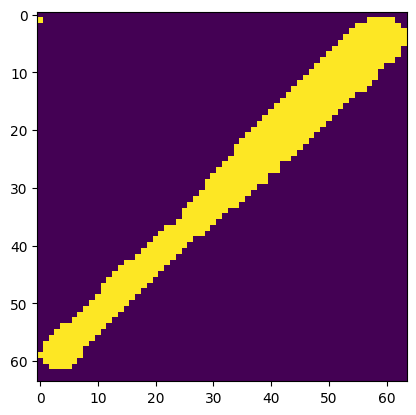

In [25]:
bin_mask = mask > 0.1
plt.imshow(bin_mask.cpu())

The mask looks good, but we can do even better by eliminating the jagged edges and abnormal holes at random places. We do that by blurring the `noise_diff` latent which also gives us a slightly larger region to edit.

Here, I chose the kernel and sigma values by simply fiddling around with them to see what worked best. Refer to the [documentation](https://pytorch.org/vision/main/generated/torchvision.transforms.GaussianBlur.html) to learn more.

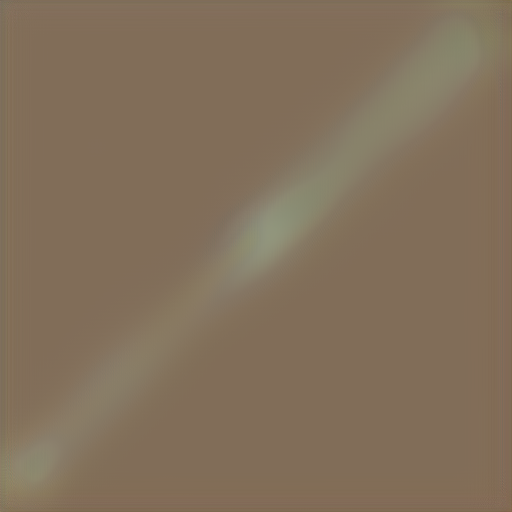

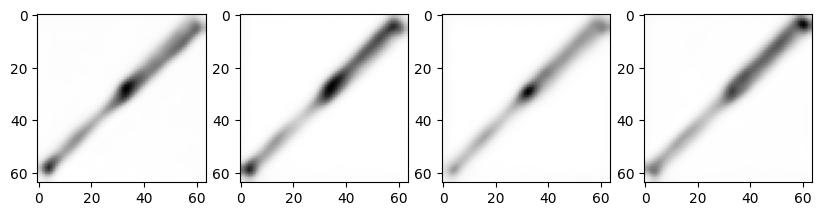

In [26]:
blurrer = tfms.GaussianBlur((9,9), sigma=1.5)
vis_latent(blurrer(noise_diff)); latents_to_pil(blurrer(noise_diff))[0]

Now, we re-compute the mask with the blurred latent.

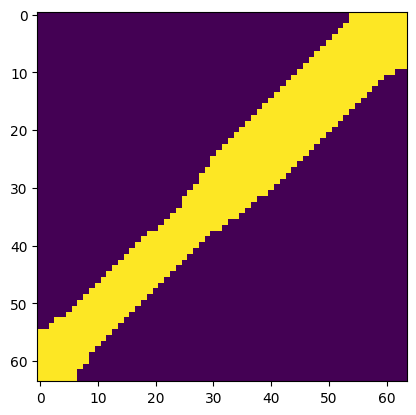

In [27]:
mask = blurrer(noise_diff)
mask = mask.squeeze().mean(0)
mask = (mask - mask.min()) / mask.max()

mask.min(), mask.max()

bin_mask = (mask > 0.09).to(torch.float32)
plt.imshow(bin_mask.cpu())

That looks much better!

In [28]:
def compute_bin_mask(noise_diff, mask_threshold=0.1, blurrer=None):
    if blurrer:
        mask = blurrer(noise_diff)
    else:
        mask = noise_diff
    mask = mask.squeeze().mean(0)
    mask = (mask - mask.min()) / mask.max()
    bin_mask = (mask > mask_threshold).to(float)
    # to avoid "mat1 and mat2 are of different dtypes" error in the last step
    return bin_mask.to(torch.float32)

Cool! Everything up to here works perfectly! Let's remind ourselves of the remaining steps:

- add noise to the image to an "extent" (referred to as the encoding ratio in the paper)
- use the img2img denoising pipeline but after each step replace the non-masked area (the purple colored area in the above image) with the image from the previous timestep.

That brings us to the next step ...

### 3.3.2. Step 2: Encoding

Let us understand what this means by referring to the timesteps vs sigmas graph.

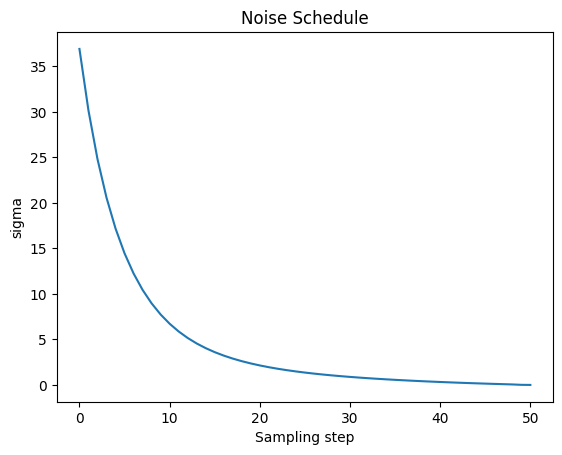

In [29]:
# Code taken from https://github.com/fastai/diffusion-nbs/blob/master/Stable%20Diffusion%20Deep%20Dive.ipynb
plt.plot(scheduler.sigmas)
plt.title('Noise Schedule')
plt.xlabel('Sampling step')
plt.ylabel('sigma')
plt.show()

In a typical txt2img pipeline, the image is initially at the 0<sup>th</sup> timestep. We try to get the image at the next timestep ((`n=n+1`)<sup>th</sup>) timestep at each denoising step and we perform this process 50 times (considering `num_inference_steps = 50`).

Here, the original image that is to be edited is considered to be at the 50<sup>th</sup> timestep. We add noise to it corresponding to timestep `r`. This is also called the encoding ratio in the paper. The choice of the encoding ratio influences the strength of the edit. Please refer to the appendix A.4. in the paper that shows the impact of the encoding ratio.



::: {.callout-note}
The paper describes the encoding step as follows: "We encode the input image x0 in the implicit latent space at timestep r with the DDIM encoding function $E_r$. This is done with the unconditional model, i.e. using conditioning text ∅, so no text input is used for this step." I didn't really understand how the image can be encoded using the conditioning text ∅ (""). I think they just mean Gaussian noise, but I'm not entirely sure.
:::

::: {.callout-note collapse="true"}
The paper also refers to `r` as both the encoding ratio and the noise timestep. I think this is a mistake in usage (or I might not be understanding it right `¯\_(ツ)_/¯`).
:::

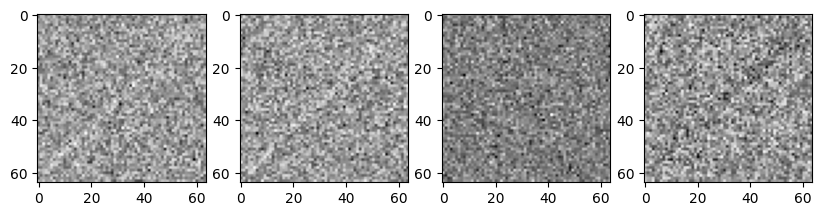

In [30]:
# According to my understanding the number of inference steps (timesteps) shouldn't matter much
scheduler.set_timesteps(100)
encoding_ratio = 0.7 # strength of edit. stronger edit => closer to 1
strength = 1 - encoding_ratio
timestep_index = round(strength * scheduler.timesteps.shape[0])
noise_timestep = scheduler.timesteps[timestep_index]
timesteps = scheduler.timesteps[timestep_index:]

noise = torch.randn_like(im_latent, device='cuda')
noisy_latent = scheduler.add_noise(im_latent, noise, timesteps=torch.tensor([noise_timestep]))

vis_latent(noisy_latent)

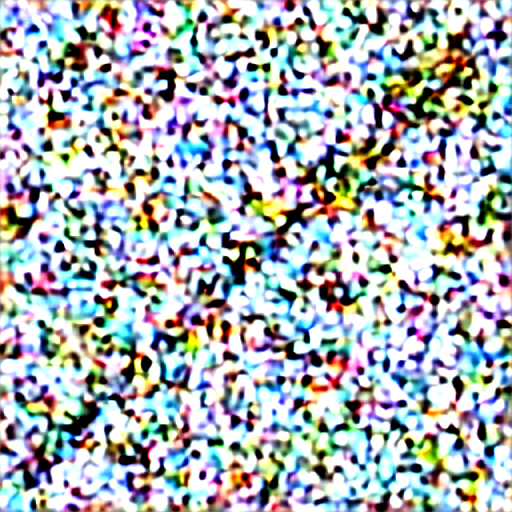

In [31]:
latents_to_pil(noisy_latent)[0]

That is it for this step. We now move on to the next and final step ...

### 3.3.3. Step 3: Decoding with Mask Guidance

At each timestep, we do the exact same thing as in a img2img pipeline — guidance and computing the latent at `r-1`<sup>th</sup> timestep — and also apply the mask. We do this denoising process until the 0<sup>th</sup> timestep.

The formula for applying the mask given in the paper is: 

\begin{equation}
\tilde{y}_t = My_t + (1-M)x_t\\
\end{equation}
\begin{align*}
\text{where:}\quad
M &= \text{binarized mask}\\
y_t &= \text{the latent at timestep } t-1 \text{ computed from the predicted noise}\\
x_t &= \text{original image latent noised at timestep } t-1
\end{align*}

$\tilde{y_t}$ is then used as the input to the UNet in the next step.

In [32]:
text_embeddings = torch.cat([uncond_emb, query_emb])
guidance = 12

for i,t in tqdm(enumerate(timesteps), total=len(timesteps)):
    latent_model_input = torch.cat([noisy_latent] * 2)
    latent_model_input = scheduler.scale_model_input(latent_model_input, t)

    with torch.no_grad():
        pred_uncond, pred_cond = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    noise_pred = pred_uncond + guidance * (pred_cond - pred_uncond)
    if (i != timesteps.shape[0]):
        x_t = scheduler.add_noise(im_latent, torch.randn_like(im_latent, device='cuda'), torch.tensor([t]))
    else:
        x_t = im_latent
        
    y_t = scheduler.step(noise_pred, t, noisy_latent).prev_sample
    noisy_latent = bin_mask * y_t + ((1 - bin_mask) * x_t)

  0%|          | 0/70 [00:00<?, ?it/s]

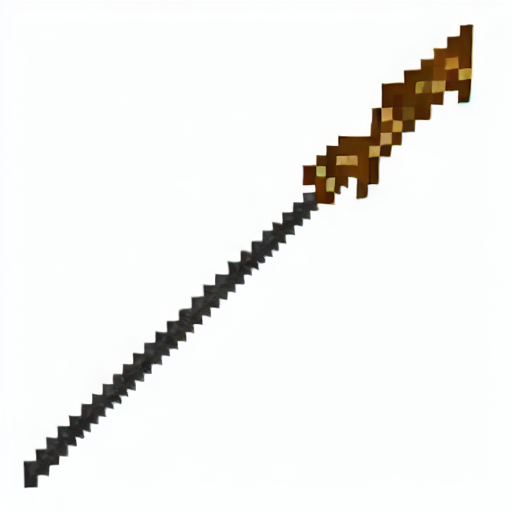

In [33]:
latents_to_pil(noisy_latent)[0]

Well, that looks like a cooked fish stuck on top of the stick 😂 and it works!

In [34]:
def txt2edited(im_latent, query_emb, uncond_emb, bin_mask, encoding_ratio=0.6, guidance_scale=7, callback=None, callback_steps=5):
    scheduler.set_timesteps(100)
    strength = 1 - encoding_ratio
    timestep_index = round(strength * scheduler.timesteps.shape[0])
    noise_timestep = scheduler.timesteps[timestep_index]
    timesteps = scheduler.timesteps[timestep_index:]

    noise = torch.randn_like(im_latent, device='cuda')
    noisy_latent = scheduler.add_noise(im_latent, noise, timesteps=torch.tensor([noise_timestep]))
    
    text_embeddings = torch.cat([uncond_emb, query_emb])
    inter_imgs = []
    print("Editing image ...")
    for i,t in tqdm(enumerate(timesteps), total=len(timesteps)):
        latent_model_input = torch.cat([noisy_latent] * 2)
        latent_model_input = scheduler.scale_model_input(latent_model_input, t)

        with torch.no_grad():
            pred_uncond, pred_cond = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

        noise_pred = pred_uncond + guidance_scale * (pred_cond - pred_uncond)
        if (i != timesteps.shape[0]):
            x_t = scheduler.add_noise(im_latent, torch.randn_like(im_latent, device='cuda'), torch.tensor([t]))
        else:
            x_t = im_latent

        y_t = scheduler.step(noise_pred, t, noisy_latent).prev_sample
        noisy_latent = bin_mask * y_t + ((1 - bin_mask) * x_t)
        vis_lat = bin_mask * y_t + ((1 - bin_mask) * im_latent)
        
        if callback and i % callback_steps == 0:
            callback(vis_lat, inter_imgs)
            
    return (noisy_latent, inter_imgs) if callback else (noisy_latent, None)

Editing image ...


  0%|          | 0/70 [00:00<?, ?it/s]

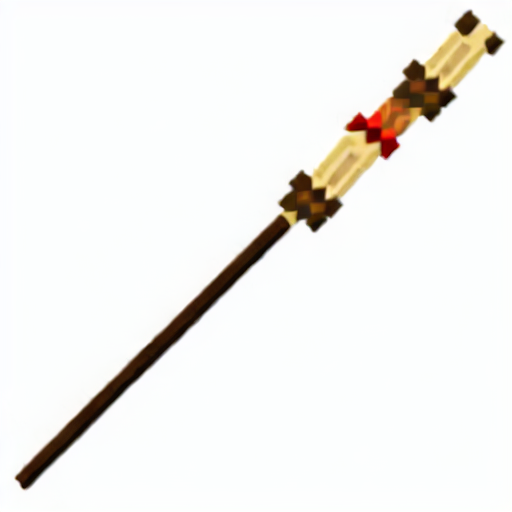

In [35]:
tmp,_ = txt2edited(im_latent, query_emb, uncond_emb, bin_mask, 0.7, 12); latents_to_pil(tmp)[0]

We can now put this all into a single function that takes the following as inputs:

- PIL image to be edited

- description of the image (default: "")

- query prompt

- num_diffs (default: 15, the number of noise differences to average)

- mask_threshold (default: 0.1)

- encoding_ratio (default: 0.7)

- guidance_scale (default: 12, to be used in the `txt2edited` function)

and gives out the edited image.

In [36]:
def diffEdit(img, query_prompt, ref_prompt="", num_diffs=15, seed=42, mask_threshold=0.1, blurrer=None, encoding_ratio=0.7, guidance_scale=12, callback=None, callback_steps=5):
    im_latent = pil_to_latent(img)
    query_emb = get_emb_from_prompt(query_prompt)
    ref_emb = get_emb_from_prompt(ref_prompt)
    noise_diff = compute_diff(im_latent, query_emb, ref_emb, uncond_emb, num_diffs, seed)
    bin_mask = compute_bin_mask(noise_diff, mask_threshold, blurrer)
    edited_latent, inter_imgs = txt2edited(im_latent, query_emb, uncond_emb, bin_mask, encoding_ratio, guidance_scale, callback, callback_steps)
    return latents_to_pil(edited_latent)[0], inter_imgs

# 4. Trying it out!

Let's try this out on a bunch of images.

In [37]:
! curl -o girlpearl.jpg "https://upload.wikimedia.org/wikipedia/commons/e/ec/Jan_Vermeer_van_Delft_007.jpg"
! curl -o mango.jpg "https://th.bing.com/th/id/OIP.7oFUha7cBXUILXk11CNQVAHaE8?rs=1&pid=ImgDetMain"
! curl -o cat.jpg "https://c.pxhere.com/photos/12/00/cat_young_animal_attention_domestic_cat_felidae_mackerel_pride_trustful-781502.jpg!d"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  737k  100  737k    0     0  3609k      0 --:--:-- --:--:-- --:--:-- 3617k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 20941  100 20941    0     0   135k      0 --:--:-- --:--:-- --:--:--  136k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  362k  100  362k    0     0   929k      0 --:--:-- --:--:-- --:--:--  930k


In [38]:
img_list = list(map(Image.open, ["girlpearl.jpg", "mango.jpg", "cat.jpg"]))
for i in range(len(img_list)):
    img_list[i] = img_list[i].resize((512, 512))

Here, instead of writing the function calls for the three images separately, we can use the `map()` function of python that calls the given function with the arguments supplied to it. We also want to have some default arguments. So, we will use `functools.partial` for that, which creates a partial function with default arguments.

In [39]:
queries = ["monalisa", "bowl of apples", "dog"]
refs = ["girl with a pearl earring", "bowl of mangoes", "cat"]

# https://stackoverflow.com/questions/47859209/how-to-map-over-a-function-with-multiple-arguments-in-python
from functools import partial
outs = list(map(partial(diffEdit, blurrer=blurrer, callback=accumulate_images), img_list, queries, refs))

Computing average noise estimate difference ...


  0%|          | 0/15 [00:00<?, ?it/s]

Editing image ...


  0%|          | 0/70 [00:00<?, ?it/s]

Computing average noise estimate difference ...


  0%|          | 0/15 [00:00<?, ?it/s]

Editing image ...


  0%|          | 0/70 [00:00<?, ?it/s]

Computing average noise estimate difference ...


  0%|          | 0/15 [00:00<?, ?it/s]

Editing image ...


  0%|          | 0/70 [00:00<?, ?it/s]

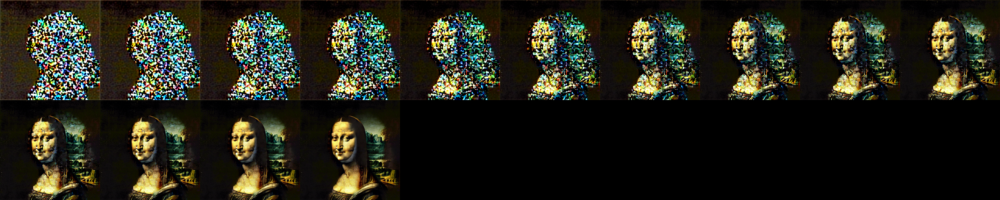

In [40]:
image_grid(outs[0][1])

Let's animate the intermediate latent updates, because why not!

In [41]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def update(d):
    ax.clear()
    ax.axis('off')
    ax.imshow(imgs[d])

imgs = outs[0][1]
fig,ax = plt.subplots()
# https://stackoverflow.com/questions/44665183/cant-remove-matplotlibs-padding-around-imshow-figure
fig.subplots_adjust(bottom=0, top=1, left=0, right=1)
ani = FuncAnimation(fig, update, frames=len(imgs), interval=200, repeat=False)
plt.close()
HTML(ani.to_jshtml())

That looks absolutely fantastic! Feel free to play around with this notebook by clicking on the "copy and edit" button [here (redirects to Kaggle)](https://www.kaggle.com/code/suchitg04/diffedit-blog).

# 5. Takeaways

I had so much fun writing this blog, especially the final few code cells where I used many things taught by Jeremy Howard in the [part 2 of course.fast.ai](https://course.fast.ai/Lessons/part2.html).

A couple of things could have been improved including but not limited to: code quality, my problem solving skills (to reduce idea $\rightarrow$ working code time-gap), and blog structuring. While I could spend another week to better the post, I think perfectionism isn't worth chasing at this point and this will also serve as a reference point to compare my work in the future to see how much I have improved. Other than that, this endeavour was a good programming exercise as well!

Thank you for reading my blog. You can reach out to me through my socials here:

- Discord - “lostsquid.”
- LinkedIn - /in/suchitg04/

I hope to see you soon. Until then 👋